# Setup

In [1]:
# widen jupyter notebook window
from IPython.display import display, HTML
display(HTML("<style>.container {width:95% !important; }</style>"))

# check environment
import os
print(f'Conda Environment: ' + os.environ['CONDA_DEFAULT_ENV'])

from platform import python_version
print(f'python version: {python_version()}')

Conda Environment: ROICaT
python version: 3.9.16


In [2]:
import os
from pathlib import Path
import copy

import matplotlib.pyplot as plt
import numpy as np
import natsort

import torch

import gc
import time
import functools
import multiprocessing as mp


In [3]:
tic = time.time()
toc = {}
toc['start'] = time.time() - tic

In [4]:
%load_ext autoreload
%autoreload 2
import roicat
# from roicat import helpers, data_importing, ROInet
# from roicat.tracking import alignment, blurring, clustering, scatteringWaveletTransformer, similarity_graph, visualization

# Import paths

In [5]:
dir_allOuterFolders = str(Path(r'C:\Users\janet\Documents\statOps').resolve())

pathSuffixToStat = 'stat.npy'
pathSuffixToOps = 'ops.npy'

paths_allStat = test = roicat.helpers.find_paths(
    dir_outer=dir_allOuterFolders,
    reMatch=pathSuffixToStat,
    depth=4,
)[:2]
paths_allOps  = np.array([Path(path).resolve().parent / pathSuffixToOps for path in paths_allStat])[:]
# paths_allOps = test = roicat.helpers.find_paths(
#     dir_outer=dir_allOuterFolders,
#     reMatch=pathSuffixToOps,
#     depth=4,
# )[:]

print(f'paths to all stat files:');
[print(path) for path in paths_allStat];
print('');
print(f'paths to all ops files:');
[print(path) for path in paths_allOps];


paths to all stat files:
C:\Users\janet\Documents\statOps\20230314\stat.npy
C:\Users\janet\Documents\statOps\20230315\stat.npy

paths to all ops files:
C:\Users\janet\Documents\statOps\20230314\ops.npy
C:\Users\janet\Documents\statOps\20230315\ops.npy


In [6]:
toc['import_paths'] = time.time() - tic

# Import data

In [7]:
toc['import_data'] = time.time() - tic

In [8]:
data = roicat.data_importing.Data_suite2p(
    paths_statFiles=paths_allStat[:],
    paths_opsFiles=paths_allOps[:],
    um_per_pixel=2.5,
    new_or_old_suite2p='new',

    out_height_width=[36,36],
    
    type_meanImg='meanImgE',
#     FOV_images=FOVs_mixed,

    verbose=True,
)

assert data.check_completeness(verbose=False)['tracking'], f"Data object is missing attributes necessary for tracking."

Starting: Importing FOV images from ops files
Completed: Set FOV_height and FOV_width successfully.
Completed: Imported 2 FOV images.
Completed: Set FOV_images for 2 sessions successfully.
Importing spatial footprints from stat files.


100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:01<00:00,  1.01it/s]


Imported 2 sessions of spatial footprints into sparse arrays.
Completed: Set spatialFootprints for 2 sessions successfully.
Completed: Created sessionID_concat.
Completed: Created centroids.
Staring: Creating centered ROI images from spatial footprints...
Completed: Created ROI images.



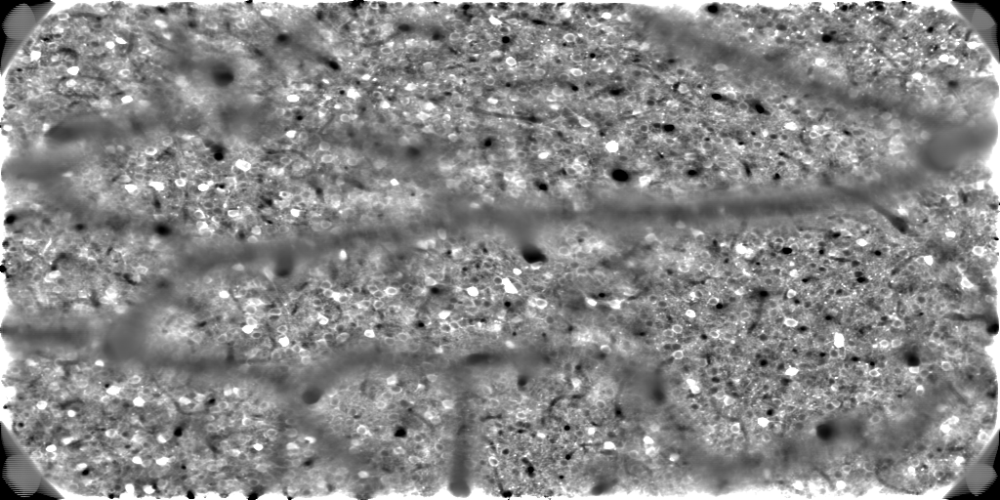


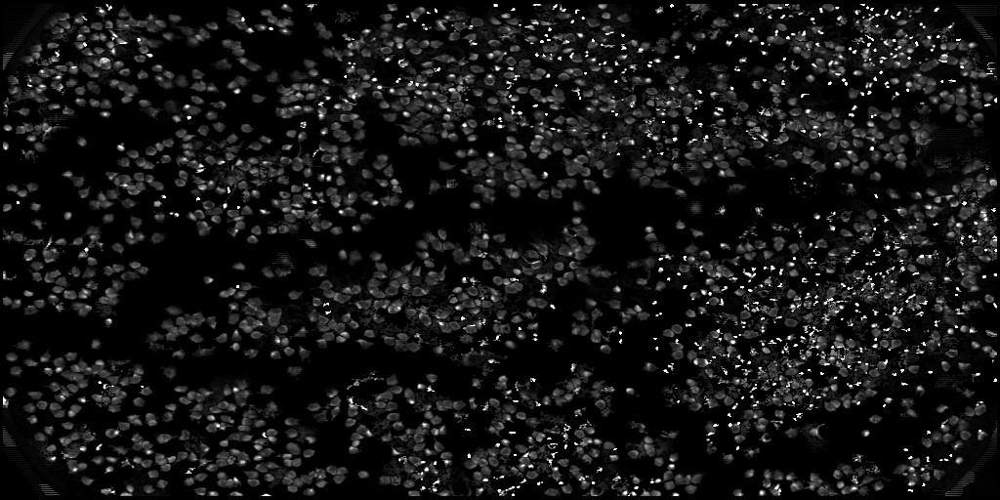


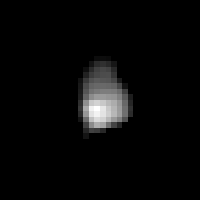

In [9]:
roicat.visualization.display_toggle_image_stack(data.FOV_images)

roicat.visualization.display_toggle_image_stack([sf.max(0).reshape(data.FOV_height, data.FOV_width).toarray() for sf in data.spatialFootprints], clim=[0,0.05])

roicat.visualization.display_toggle_image_stack(np.concatenate(data.ROI_images, axis=0)[:5000], image_size=(200,200))

# Alignment

In [10]:
use_CLAHE = True

position_session_template = 0.5
roi_FOV_image_mixing_factor = 0.5

idx_st = int(position_session_template * data.n_sessions) if type(position_session_template) is float else position_session_template

FOV_images = [f + np.array(roi_FOV_image_mixing_factor*(sf.multiply(1/sf.max(1).A)).sum(0).reshape(data.FOV_height, data.FOV_width)) for f, sf in zip(data.FOV_images, data.spatialFootprints)]
FOV_images = [roicat.tracking.alignment.clahe(im, grid_size=1, clipLimit=1, normalize=True) for im in FOV_images] if use_CLAHE else FOV_images


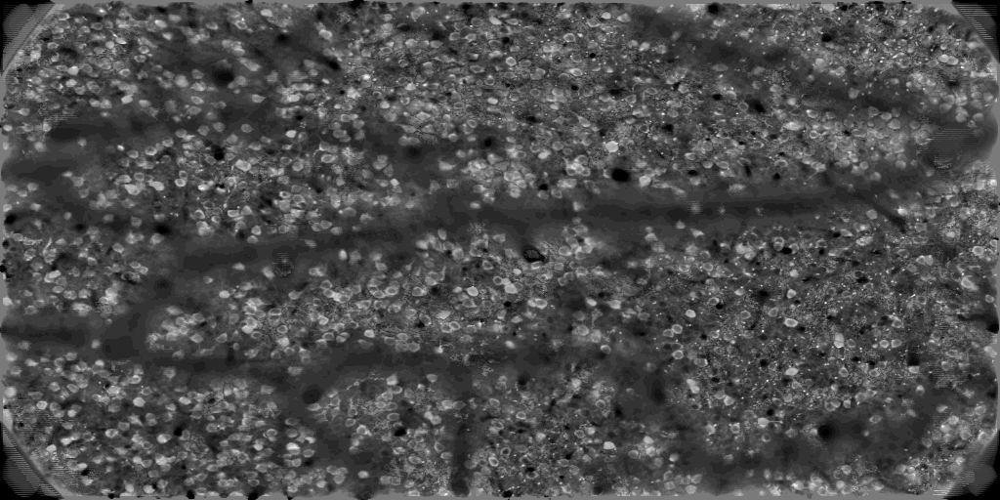

In [11]:
roicat.visualization.display_toggle_image_stack(FOV_images)

In [12]:
aligner = roicat.tracking.alignment.Aligner(verbose=True)
aligner.fit_geometric(
#     template=FOV_images[4],
    template=1,
    ims_moving=FOV_images,
    template_method='sequential',
    mode_transform='homography',
    mask_borders=(50,50,50,50),
    n_iter=50,
    termination_eps=1e-09,
    gaussFiltSize=31,
    auto_fix_gaussFilt_step=10,
)

aligner.transform_images_geometric(FOV_images);

Finding geometric registration warps with mode: homography, template_method: sequential, mask_borders: True


Finding geometric registration warps: 100%|██████████████████████████████████████████████| 2/2 [00:00<00:00,  2.26it/s]

Composing geometric warp matrices...
Applying geometric registration warps to images...


In [13]:
aligner.fit_nonrigid(
    template=FOV_images[1],
#     template=4,
    ims_moving=aligner.ims_registered_geo,
    remappingIdx_init=aligner.remappingIdx_geo,
    template_method='image',
    mode_transform='createOptFlow_DeepFlow',
    kwargs_mode_transform=None,
)

aligner.transform_images_nonrigid(FOV_images);

Finding nonrigid registration warps with mode: createOptFlow_DeepFlow, template_method: image


Finding nonrigid registration warps: 100%|████████████████████████████████████████████| 2/2 [00:01<00:00,  1.60image/s]

Composing nonrigid warp matrices...
Applying nonrigid registration warps to images...


In [14]:
aligner.transform_ROIs(
    ROIs=data.spatialFootprints, 
    remappingIdx=aligner.remappingIdx_nonrigid,
    normalize=True,
);

Registering ROIs...



100%|█████████████████████████████████████████████████████████████████████████████| 2452/2452 [00:04<00:00, 542.63it/s]
c:\users\janet\documents\github\roicat\roicat\tracking\alignment.py:434: RuntimeWarning: divide by zero encountered in divide
  rois_aligned = rois_aligned.multiply(1/rois_aligned.sum(1))

100%|█████████████████████████████████████████████████████████████████████████████| 2697/2697 [00:05<00:00, 536.93it/s]

Registering ROIs: 100%|██████████████████████████████████████████████████████████████████| 2/2 [00:10<00:00,  5.50s/it]



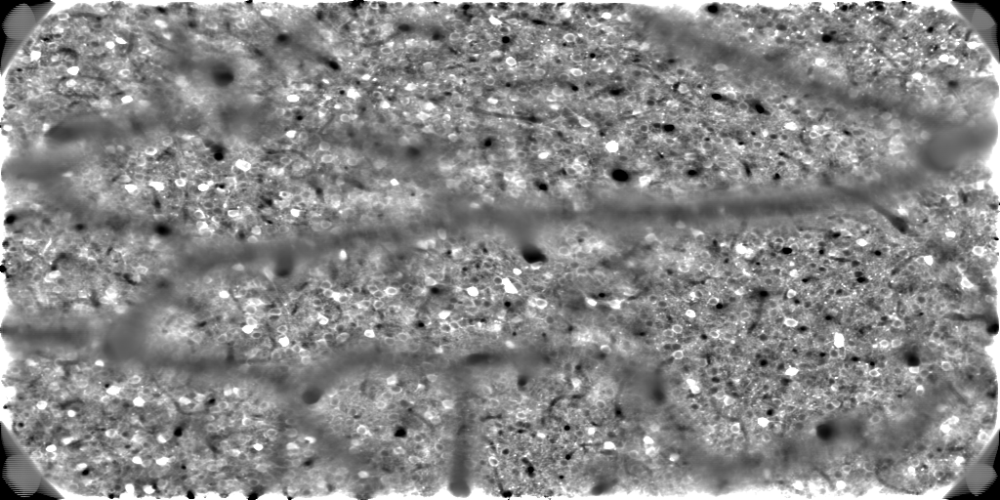


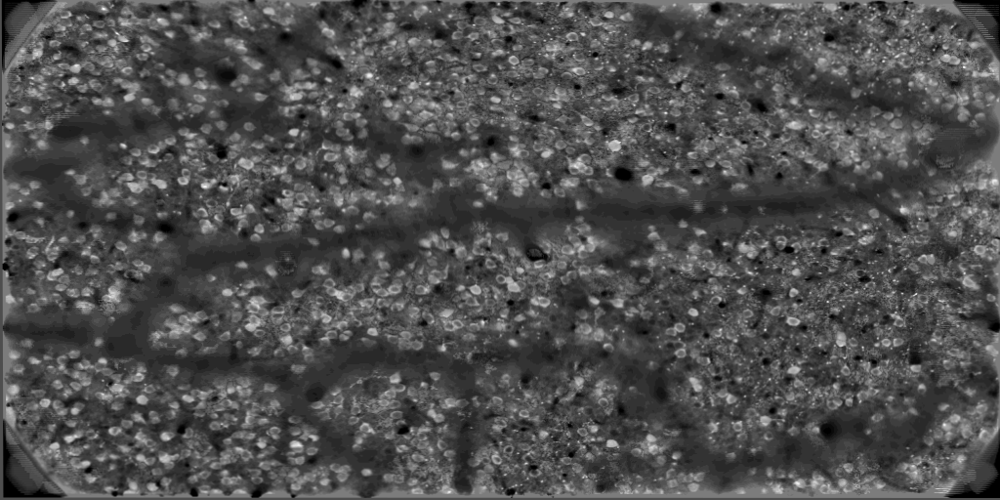


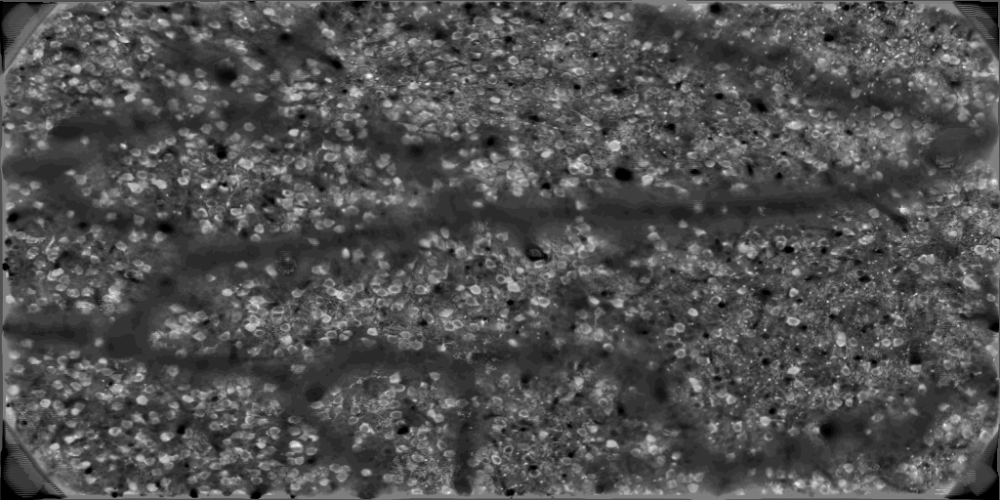


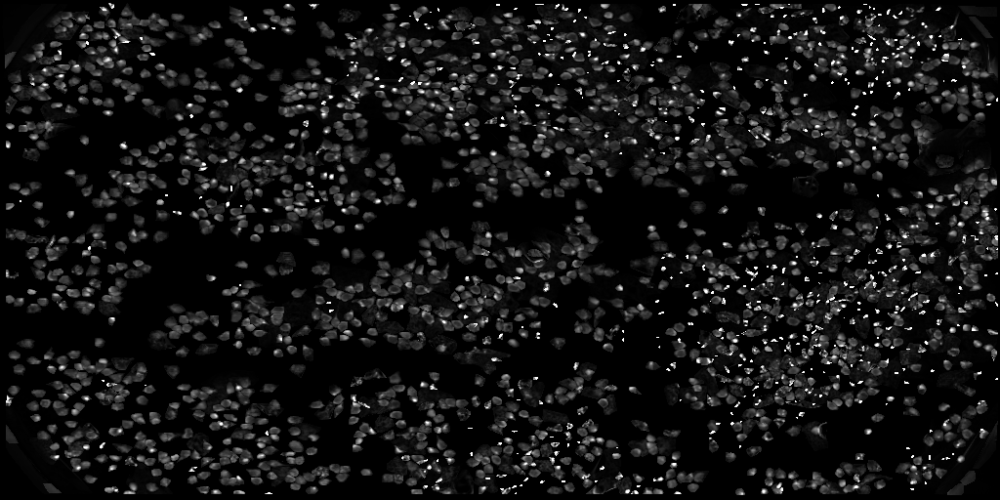

In [15]:
roicat.visualization.display_toggle_image_stack(data.FOV_images)
roicat.visualization.display_toggle_image_stack(aligner.ims_registered_geo)
roicat.visualization.display_toggle_image_stack(aligner.ims_registered_nonrigid)
roicat.visualization.display_toggle_image_stack(aligner.get_ROIsAligned_maxIntensityProjection(), clim=(0, 0.05))

In [16]:
toc['alignment'] = time.time() - tic

## Blur ROIs (optional)

In [17]:
blurrer = roicat.tracking.blurring.ROI_Blurrer(
    frame_shape=(data.FOV_height, data.FOV_width),
    kernel_halfWidth=4,
    plot_kernel=False,
)

blurrer.blur_ROIs(
    spatialFootprints=aligner.ROIs_aligned[:],
)

Preparing the Toeplitz convolution matrix
Performing convolution for blurring



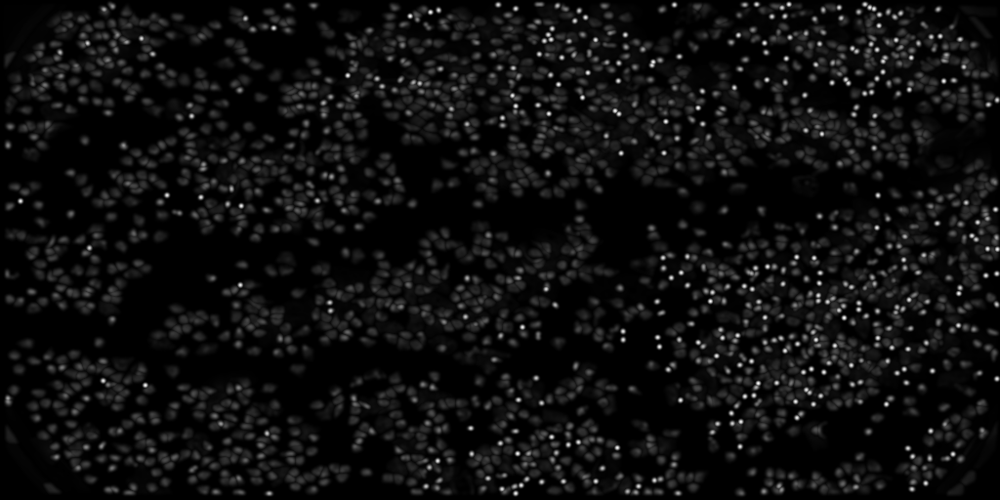

In [18]:
roicat.visualization.display_toggle_image_stack(blurrer.get_ROIsBlurred_maxIntensityProjection())

In [19]:
toc['blur'] = time.time() - tic

## Neural network embedding distances

In [20]:
roinet = roicat.ROInet.ROInet_embedder(
    device='cuda:0',
    dir_networkFiles=r'/home/rich/Desktop/tmp_data/',
    download_method='check_local_first',
    download_url='https://osf.io/x3fd2/download',
    download_hash='7a5fb8ad94b110037785a46b9463ea94',
    forward_pass_version='latent',
    verbose=True,
)

File already exists locally: C:\home\rich\Desktop\tmp_data\ROInet.zip
Hash of local file matches provided hash_hex.
Extracting C:\home\rich\Desktop\tmp_data\ROInet.zip to C:\home\rich\Desktop\tmp_data.
Completed zip extraction.
['C:\\home\\rich\\Desktop\\tmp_data\\ROInet_tracking_20220527', 'C:\\home\\rich\\Desktop\\tmp_data\\ROInet_tracking_20220527\\params.json', 'C:\\home\\rich\\Desktop\\tmp_data\\ROInet_tracking_20220527\\ReadMe.txt', 'C:\\home\\rich\\Desktop\\tmp_data\\ROInet_tracking_20220527\\model.py', 'C:\\home\\rich\\Desktop\\tmp_data\\ROInet_tracking_20220527\\ConvNext_tiny__1_0_best__simCLR.pth']
Imported model from C:\home\rich\Desktop\tmp_data\ROInet_tracking_20220527\model.py
Loaded params_model from C:\home\rich\Desktop\tmp_data\ROInet_tracking_20220527\params.json


C:\Users\janet\anaconda3\envs\ROICaT\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\janet\anaconda3\envs\ROICaT\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1`. You can also use `weights=ConvNeXt_Tiny_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Generated network using params_model
Loaded state_dict into network from C:\home\rich\Desktop\tmp_data\ROInet_tracking_20220527\ConvNext_tiny__1_0_best__simCLR.pth
Loaded network onto device cuda:0


In [21]:
roinet.generate_dataloader(
    ROI_images=data.ROI_images,
    um_per_pixel=data.um_per_pixel,
    pref_plot=False,
    
    jit_script_transforms=False,
    
    batchSize_dataloader=8,
    pinMemory_dataloader=True,
    numWorkers_dataloader=mp.cpu_count(),
    persistentWorkers_dataloader=True,
    prefetchFactor_dataloader=2,    

#     batchSize_dataloader=1,
#     pinMemory_dataloader=False,
#     numWorkers_dataloader=0,
#     persistentWorkers_dataloader=False,
#     prefetchFactor_dataloader=2,    
);

Starting: resizing ROIs
Completed: resizing ROIs
Defined image transformations: Sequential(
  (0): ScaleDynamicRange(scaler_bounds=(0, 1))
  (1): Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
  (2): TileChannels(dim=0)
)
Defined dataset
Defined dataloader



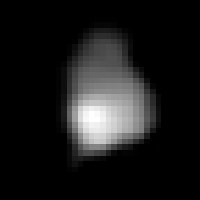

In [22]:
roicat.visualization.display_toggle_image_stack(roinet.ROI_images_rs[:5000], image_size=(200,200))

In [23]:
roinet.generate_latents();


starting: running data through network


100%|████████████████████████████████████████████████████████████████████████████████| 644/644 [00:35<00:00, 18.30it/s]

completed: running data through network


In [24]:
gc.collect()
torch.cuda.empty_cache()
gc.collect()
torch.cuda.empty_cache()

In [25]:
toc['NN'] = time.time() - tic

## Scattering wavelet embedding distances

In [26]:
swt = roicat.tracking.scatteringWaveletTransformer.SWT(
    kwargs_Scattering2D={'J': 2, 'L': 2}, 
    image_shape=data.ROI_images[0].shape[1:3], 
    device='cuda:0'
)

swt.transform(
    ROI_images=np.concatenate(data.ROI_images, axis=0),
    batch_size=100,
);

SWT initialized
Starting: SWT transform on ROIs


52it [00:00, 82.81it/s]                                                                                                

Completed: SWT transform on ROIs


In [27]:
gc.collect()
torch.cuda.empty_cache()
gc.collect()
torch.cuda.empty_cache()


In [28]:
toc['SWT'] = time.time() - tic

## Compute similarities

Computing pairwise similarity between ROIs...


100%|██████████████████████████████████████████████████████████████████████████████████| 32/32 [00:02<00:00, 12.42it/s]


Joining blocks into full similarity matrices...
Joining s_sf...
Joining s_NN...
Joining s_SWT...
Joining s_sesh...


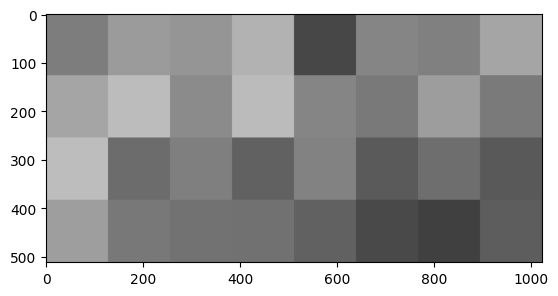

In [29]:
sim = roicat.tracking.similarity_graph.ROI_graph(
    n_workers=-1,
    frame_height=data.FOV_height,
    frame_width=data.FOV_width,
#     block_height=data.FOV_height,
#     block_width=data.FOV_width,
    block_height=128,
    block_width=128,
    algorithm_nearestNeigbors_spatialFootprints='brute',
    verbose=True,
)

sim.visualize_blocks()

s_sf, s_NN, s_SWT, s_sesh = sim.compute_similarity_blockwise(
    spatialFootprints=blurrer.ROIs_blurred,
#     spatialFootprints=aligner.ROIs_aligned,
    features_NN=roinet.latents,
    features_SWT=swt.latents,
    ROI_session_bool=data.sessionID_concat,
    spatialFootprint_maskPower=1.0,
);

In [30]:
sim.make_normalized_similarities(
    centers_of_mass=data.centroids,
    features_NN=roinet.latents,
    features_SWT=swt.latents,
#     features_SWT=None,
    k_max=4000,
    k_min=100,
    algo_NN='kd_tree',
    device='cuda:0'
)

toc['sim'] = time.time() - tic

Finding k-range of center of mass distance neighbors for each ROI...
Normalizing Neural Network similarity scores...


100%|████████████████████████████████████████████████████████████████████████████| 5149/5149 [00:01<00:00, 4617.57it/s]


Normalizing SWT similarity scores...


100%|████████████████████████████████████████████████████████████████████████████| 5149/5149 [00:01<00:00, 3624.01it/s]


# Clustering

In [31]:
clusterer = roicat.tracking.clustering.Clusterer(
    s_sf=sim.s_sf,
    s_NN_z=sim.s_NN_z,
    s_SWT_z=sim.s_SWT_z,
    s_sesh=sim.s_sesh,
)

kwargs_makeConjunctiveDistanceMatrix_best = clusterer.find_optimal_parameters_for_pruning(
    n_bins=50,
    find_parameters_automatically=True,
    kwargs_findParameters={
        'n_patience': 100,
        'tol_frac': 0.05,
        'max_trials': 350,
        'max_duration': 60*10,
        'verbose': False,
    },
    bounds_findParameters={
        'power_SF': (0.3, 2),
        'power_NN': (0.2, 2),
        'power_SWT': (0.1, 1),
        'p_norm': (-5, 5),
        'sig_NN_kwargs_mu': (0, 0.5),
        'sig_NN_kwargs_b': (0.05, 2),
        'sig_SWT_kwargs_mu': (0, 0.5),
        'sig_SWT_kwargs_b': (0.05, 2),
    },
    n_jobs_findParameters=-1,    
#     fallback_d_cutoff=0.5,
#     plot_pref=True,
)

toc['separate_diffSame'] = time.time() - tic

Finding mixing parameters using automated hyperparameter tuning...
Best value found: 0.059918858110904694 with parameters {'power_SF': 1.6085447753434154, 'power_NN': 1.9111856465305461, 'power_SWT': 0.2508864853856584, 'p_norm': -4.45725258654068, 'sig_SF_kwargs': None, 'sig_NN_kwargs': {'mu': 0.20130025836822907, 'b': 1.5033661837509935}, 'sig_SWT_kwargs': {'mu': 0.11614619502082892, 'b': 1.1391398452451549}}


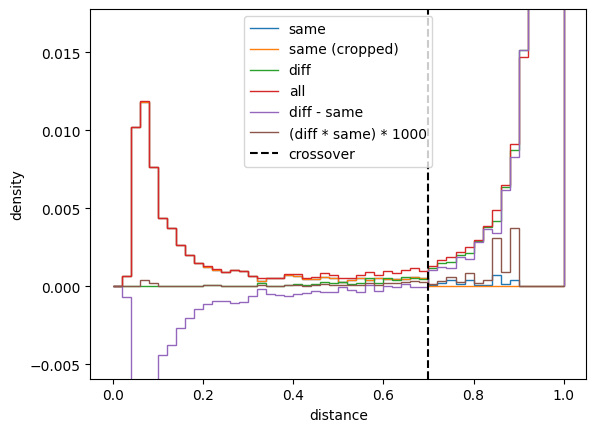

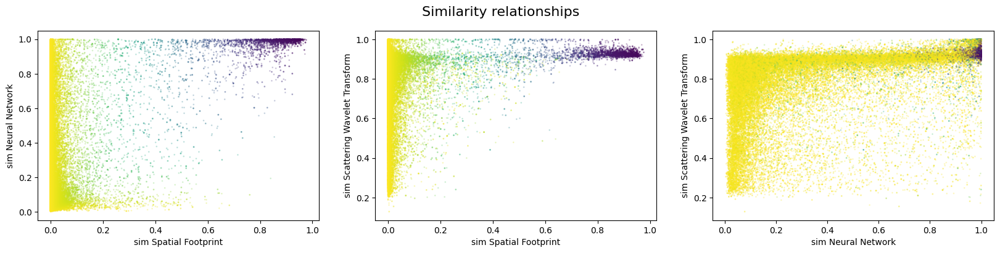

In [32]:
clusterer.plot_distSame()

clusterer.plot_similarity_relationships(
    plots_to_show=[1,2,3], 
    max_samples=100000, 
    kwargs_scatter={'s':1, 'alpha':0.2},
    kwargs_makeConjunctiveDistanceMatrix=kwargs_makeConjunctiveDistanceMatrix_best,
#     kwargs_makeConjunctiveDistanceMatrix={
#         'power_SF': 1.0,
#         'power_NN': 1.0,
#         'power_SWT': 0.1,
#         'p_norm': -4.0,
#         'sig_SF_kwargs': {'mu':0.5, 'b':4},
# #         'sig_SF_kwargs': None,
#         'sig_NN_kwargs': {'mu':0.5, 'b':1.5},
#         'sig_SWT_kwargs': {'mu':0.5, 'b':0.5},
#     },
);

In [33]:
clusterer.make_pruned_similarity_graphs(
    d_cutoff=None,
    kwargs_makeConjunctiveDistanceMatrix=kwargs_makeConjunctiveDistanceMatrix_best,
    stringency=0.8,
)

Pruning similarity graphs with d_cutoff = 0.5643814325332642...


C:\Users\janet\anaconda3\envs\ROICaT\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


In [34]:
if data.n_sessions >= 8:
    labels = clusterer.fit(
        session_bool=data.sessionID_concat,
        min_cluster_size=2,
        cluster_selection_method='leaf',
        d_clusterMerge=None,
        alpha=0.999,
        n_iter_violationCorrection=4,
        d_conj=clusterer.dConj_pruned,
#             kwargs_makeConjunctiveDistanceMatrix=kwargs_makeConjunctiveDistanceMatrix_best,
    #     kwargs_makeConjunctiveDistanceMatrix={
    #         'power_SF': 1.0,
    #         'power_NN': 1.0,
    #         'power_SWT': 0.1,
    #         'p_norm': -2,
    #         'sig_SF_kwargs': None,
    #         'sig_NN_kwargs':  {'mu':0, 'b':0.2},
    #         'sig_SWT_kwargs': {'mu':0, 'b':0.2},
    #     },
        split_intraSession_clusters=True,
        discard_failed_pruning=True,
        d_step=0.02,
    )

else:
    labels = clusterer.fit_sequentialHungarian(
        session_bool=data.sessionID_concat,
        thresh_cost=0.6,
        d_conj=clusterer.dConj_pruned,
#             kwargs_makeConjunctiveDistanceMatrix=kwargs_makeConjunctiveDistanceMatrix_best,
    #     kwargs_makeConjunctiveDistanceMatrix={
    #     'power_SF': 1.0,
    #     'power_NN': 1.0,
    #     'power_SWT': 0.1,
    #     'p_norm': -2,
    #     'sig_SF_kwargs': None,
    #     'sig_NN_kwargs':  {'mu':0, 'b':0.2},
    #     'sig_SWT_kwargs': {'mu':0, 'b':0.2},
    #     },
    )

clusterer.compute_cluster_quality_metrics(
    sim_mat=clusterer.sConj, 
    labels=clusterer.labels,
)

labels_bySession = [labels[idx] for idx in data.sessionID_concat.T]

Clustering with CaImAn's sequential Hungarian algorithm method...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  5.71it/s]

In [35]:
## results_clustering
print(f'Number of clusters: {len(np.unique(labels))}')
print(f'Number of discarded ROIs: {(labels==-1).sum()}')

Number of clusters: 1879
Number of discarded ROIs: 1393


In [36]:
toc['clustering'] = time.time() - tic

# Visualize results

Text(0, 0.5, 'ROI counts')

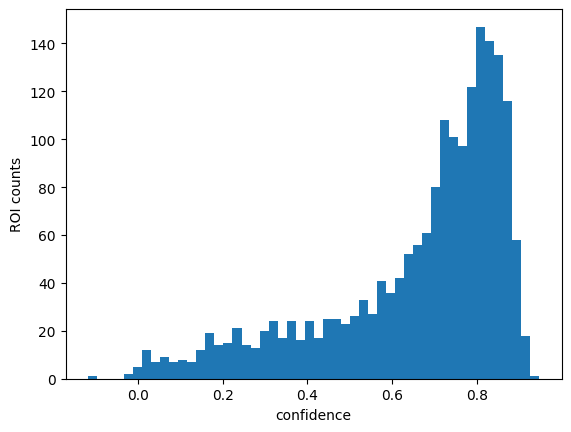

In [37]:
confidence = (clusterer.cluster_quality_metrics['cs_sil'] * clusterer.cluster_quality_metrics['cs_intra_means'] * clusterer.cluster_quality_metrics['cs_intra_mins'])

plt.figure()
plt.hist(confidence, 50);
plt.xlabel('confidence');
plt.ylabel('ROI counts')

In [38]:
FOV_clusters = roicat.visualization.compute_colored_FOV(
    spatialFootprints=[r.power(0.7) for r in aligner.ROIs_aligned],
    FOV_height=data.FOV_height,
    FOV_width=data.FOV_width,
    boolSessionID=data.sessionID_concat,
    labels=labels,
#     alphas=confidence / np.percentile(confidence, 90),
#     alphas=(confidence < 0.1) * (confidence > 0.0),
    alphas=confidence > 0.2,
)

c:\users\janet\documents\github\roicat\roicat\visualization.py:188: RuntimeWarning: divide by zero encountered in divide
  rois = rois.multiply(1.2/rois.max(1).A).power(1)



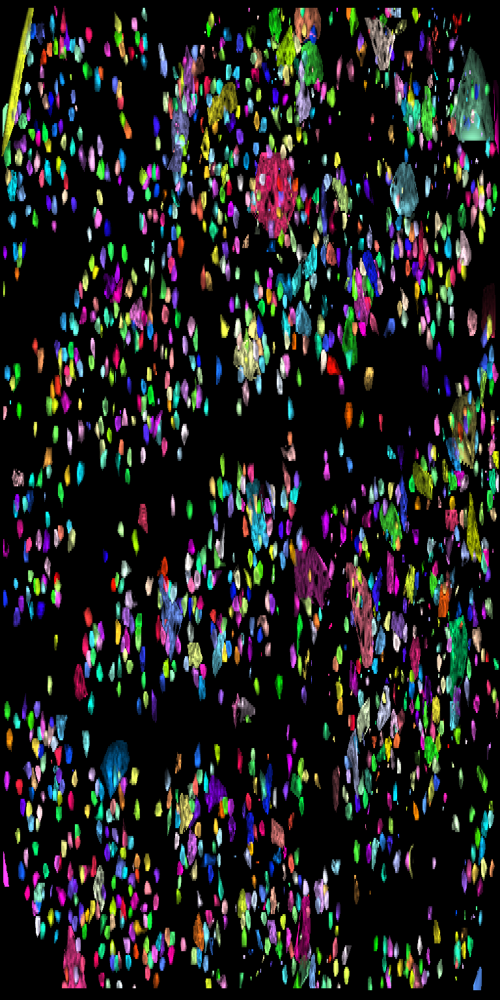

In [39]:
roicat.visualization.display_toggle_image_stack(
    FOV_clusters, 
    image_size=(np.array(FOV_clusters[0].shape)*1.5).astype(int)[:2]
)

C:\Users\janet\AppData\Local\Temp\ipykernel_3600\3423584665.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(40,1))


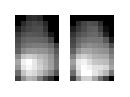

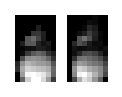

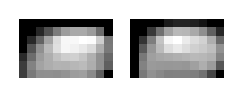

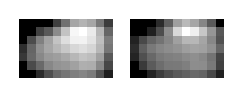

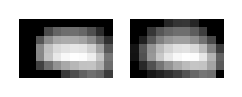

...

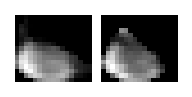

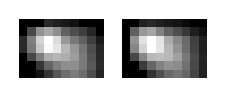

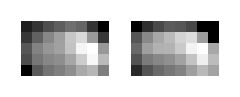

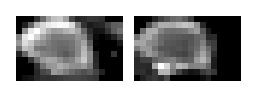

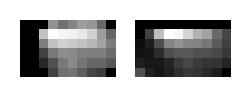

In [40]:
import scipy.sparse

ucids = labels.copy()
# ucids = ucids[ucids==975]
ucids_unique = np.unique(ucids[ucids>-1])

# ROI_ims = np.concatenate(data.ROI_images, axis=0)
ROI_ims_sparse = scipy.sparse.vstack(aligner.ROIs_aligned)
ROI_ims_sparse = ROI_ims_sparse.multiply( ROI_ims_sparse.max(1).power(-1) ).tocsr()


ucid_sfCat = []
for ucid in ucids_unique:
    idx = np.where(ucids == ucid)[0]
    ucid_sfCat.append( np.concatenate(list(roicat.visualization.crop_cluster_ims(ROI_ims_sparse[idx].toarray().reshape(len(idx), data.FOV_height, data.FOV_width))), axis=1) )
#     ucid_sfCat.append( np.concatenate(list(ROI_ims_sparse[idx].toarray().reshape(len(idx), data.FOV_height, data.FOV_width)), axis=1) )
# data.ROI_images[i_sesh][idx] for 


%matplotlib inline

for sf in ucid_sfCat[:100]:
    plt.figure(figsize=(40,1))
    plt.imshow(sf, cmap='gray')
    plt.axis('off')

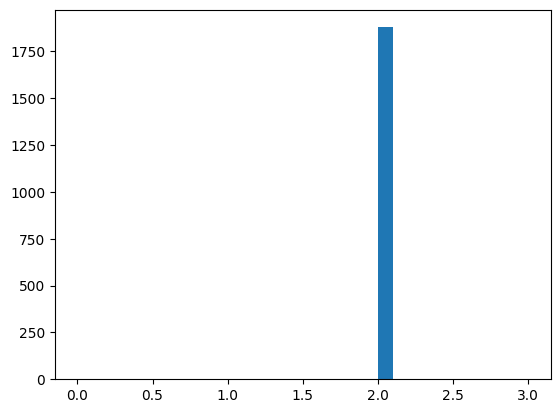

In [41]:
_, counts = np.unique(labels, return_counts=True)

plt.figure()
plt.hist(counts, 30, range=(0, data.n_sessions+1));


In [42]:
toc['visualize'] = time.time() - tic

# Save results

In [43]:
dir_save = Path(r'C:\Users\janet\Documents\statOps').resolve()
name_save = Path(dir_allOuterFolders).resolve().name
# name_save = 'RE257'
# path_save = dir_save / (name_save + '.ROICaT.tracking.results' + '.pkl')
path_save = dir_save / (name_save + '.ROICaT.tracking.results' + '.pkl')
print(f'path_save: {path_save}')

path_save: C:\Users\janet\Documents\statOps\statOps.ROICaT.tracking.results.pkl


In [44]:
ROIs = {
    "ROIs_aligned": aligner.ROIs_aligned,
    "ROIs_raw": data.spatialFootprints,
    "frame_height": data.FOV_height,
    "frame_width": data.FOV_width,
    "idx_roi_session": np.where(data.sessionID_concat)[1]
}

results = {
    "UCIDs": labels,
    "UCIDs_bySession": labels_bySession,
    "ROIs": ROIs,
    "input_data": {
        "paths_stat": data.paths_stat,
        "paths_ops": data.paths_ops,
    },
    "cluster_quality_metrics": clusterer.cluster_quality_metrics,
}

roicat.helpers.pickle_save(
    obj=results,
    path_save=path_save,
    mkdir=True,
)

run_data = copy.deepcopy({
    'data': data.serializable_dict,
    'aligner': aligner.serializable_dict,
    'blurrer': blurrer.serializable_dict,
    'roinet': roinet.serializable_dict,
    'swt': swt.serializable_dict,
    'sim': sim.serializable_dict,
    'clusterer': clusterer.serializable_dict,
})
roicat.helpers.pickle_save(
    obj=run_data,
    path_save=str(dir_save / (name_save + '.ROICaT.tracking.rundata' + '.pkl')),
    mkdir=True,
)


In [45]:
toc['saving'] = time.time() - tic

In [46]:
toc

{'start': 0.0,
 'import_paths': 9.052058458328247,
 'import_data': 12.426485300064087,
 'alignment': 79.8910641670227,
 'blur': 88.68216896057129,
 'NN': 158.88193035125732,
 'SWT': 166.90443062782288,
 'sim': 180.23596811294556,
 'separate_diffSame': 188.17365050315857,
 'clustering': 206.22020602226257,
 'visualize': 233.02951765060425,
 'saving': 241.65116167068481}